In [1]:
# imports

# test alter

import re
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from pathlib import Path

%matplotlib inline

In [2]:
'''Creating planet and solar system class to initialize al objects wanting to be modeled'''

class Celestial_Object():
    def __init__(self, file_name):
        
        G = 6.67430e-11 / (1000)**3   # km^3 kg^-1 s^-2
        check = 0
        with open(file_name) as f:
            lines=f.readlines()
            for i in range(len(lines)):
                line = lines[i]

                if("Target body name:" in line):
                    self.name = line.split()[3]
                elif(("GM," in line and check == 0) or 
                     ("GM " in line and check == 0) or
                     ("GM=" in line and check == 0)):
                    check = 1
                    line = re.sub(r"^.*?GM", "GM", line)
                    for c in line.split():
                        c = c.replace("+-", "")
                        try:
                            GM = float(c)
                            break
                        except ValueError:
                            continue
                        
                    self.mass = GM/G
                elif("$$SOE" in line):
                    pos_i = i + 2
                    vel_i = i + 3
                    break
        
            pos_data = lines[pos_i].split(sep = "=")[1:]
            vel_data = lines[vel_i].split(sep = "=")[1:]

            replacements = [(" ", ""), ("Y", ""), ("Z", ""), 
                            ("\n", ""), ("V", "")]
            
            out_list = []
            for arr in [pos_data, vel_data]:
                for j in range(len(arr)):
                    for char, replacement in replacements:
                        if char in arr[j]:
                            arr[j] = arr[j].replace(char, replacement)

                out_list.append(arr)

            pos_data, vel_data = out_list

            self.r_0 = np.array(list(map(float, pos_data)))*1000   # m
            self.v_0 = np.array(list(map(float, vel_data)))*1000   # m/s
    
class Solar_System():
    def __init__(self, objects, t_0, t_f, delta_t):
        
        self.G = 6.67430e-11

        self.objects = objects
        
        self.delta_t = delta_t

        self.initialize(t_0, t_f)
        
    def initialize(self, t_0, t_f):
        self.n = int(np.ceil((t_f-t_0)/self.delta_t))
        self.t = np.zeros(self.n)
        self.r_arrays = {}
        self.v_arrays = {}
        
        for object in self.objects:
            self.r_arrays["{0}".format(object.name)] = np.zeros((self.n,3))
            self.v_arrays["{0}".format(object.name)] = np.zeros((self.n,3))
     
            self.r_arrays["{0}".format(object.name)][0] = object.r_0
            self.v_arrays["{0}".format(object.name)][0] = object.v_0
                    
    def Velocity_Verlet(self):
        for j in range(self.n-1):
            self.acceleration_orbit(j = j)
            self.velocity(j = j)
            self.t[j+1] = self.t[j] + self.delta_t

    ############################################################################################################
    # Below are functions to alter/work on

    def acceleration_orbit(self, j):
        for key in self.r_arrays.keys():
            a = 0
            for o in self.objects:
                call = o.name
                if call != key:
                    r_diff = self.r_arrays[key][j] - self.r_arrays[call][j]
                    rmag = np.linalg.norm(r_diff)
                    a += ((-self.G*o.mass*r_diff)/(rmag**3))
            
            self.r_arrays[key][j+1] = self.r_arrays[key][j] + self.delta_t*self.v_arrays[key][j]\
                                      + 0.5*(self.delta_t**2)*a
                        
    def velocity(self, j):
        for key in self.r_arrays.keys():
            a = 0
            for o in self.objects:
                call = o.name
                if call != key:
                    r_diff0 = self.r_arrays[key][j]-self.r_arrays[call][j]
                    rmag0 = np.linalg.norm(r_diff0)
                    a += ((-self.G*o.mass*r_diff0)/(rmag0**3))

                    r_diff1 = self.r_arrays[key][j+1]-self.r_arrays[call][j+1]
                    rmag1 = np.linalg.norm(r_diff1)
                    a += ((-self.G*o.mass*r_diff1)/(rmag1**3))

            self.v_arrays[key][j+1] = self.v_arrays[key][j] + 0.5*self.delta_t*a

In [3]:
object_dict = {}

pathlist = Path("object_data").glob('*')
for path in pathlist:
    path_str = str(path)
    object = Celestial_Object(path_str)  
    object_dict[object.name] = object
    print(object.name, object.mass)

sorted_objects = dict(sorted(object_dict.items(), key = lambda item: np.linalg.norm(item[1].r_0)))

object_arr = np.array(list((sorted_objects.values())))

Callisto 1.0756608782943532e+23
Ceres 9.383515874323901e+20
Deimos 1799999850171554.0
Dione 1.0954856689090993e+21
Earth 5.972168398723463e+24
Enceladus 1.0803180857917686e+20
Eris 1.6018159207707176e+22
Europa 4.798573783018445e+22
Ganymede 1.4814786269721172e+23
Iapetus 1.8057324363603677e+21
Io 8.929648802121572e+22
Jupiter 1.8981246258034555e+27
Mars 6.416908921385016e+23
Mercury 3.301000636770898e+23
Mimas 3.750938675216877e+19
Moon 7.345789170399893e+22
Neptune 1.0240924096909041e+26
Phobos 1.0799999850171556e+16
Pluto 1.302497640201969e+22
Saturn 5.683173701212113e+26
Sun 1.9884098713264222e+30
Tethys 6.174430277332456e+20
Titan 1.3451807680206165e+23
Uranus 8.680987153709004e+25
Venus 4.867305814842006e+24


In [4]:
'''The following simulates solar system starting on Jan 1st 2000'''

#Creating the Solar System object
SolarSys = Solar_System(object_arr, t_0 = 0, t_f = 1*(365*24*3600), delta_t = 0.05*(3600*24))

#Runs Velocity Verlet Numerical Method
SolarSys.Velocity_Verlet()

(-1.5, 1.5)

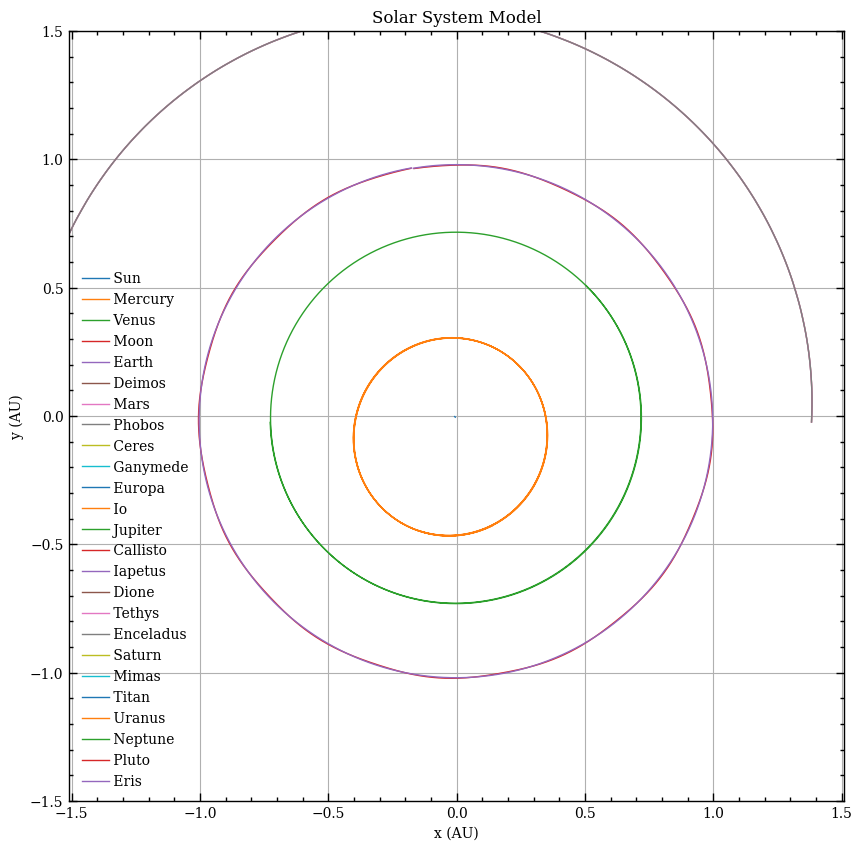

In [5]:
AU = 1.495978707e11   # m

plt.figure(figsize=(10,10))
#plt.scatter(0, 0, color = "orange", s = 50, marker = "*", label = "Sun")

for object in object_arr:
    name = object.name
    plt.plot(SolarSys.r_arrays[name][:,0]/AU, SolarSys.r_arrays[name][:,1]/AU, label = " "+name)

plt.title("Solar System Model")
plt.xlabel("x (AU)")
plt.ylabel("y (AU)")

plt.legend()
plt.axis('equal')
plt.grid()

high = 1.5
low = -1*high
plt.xlim(low, high)
plt.ylim(low, high)

#plt.xlim(-1, -0.5)
#plt.ylim(0.7, 0.9)

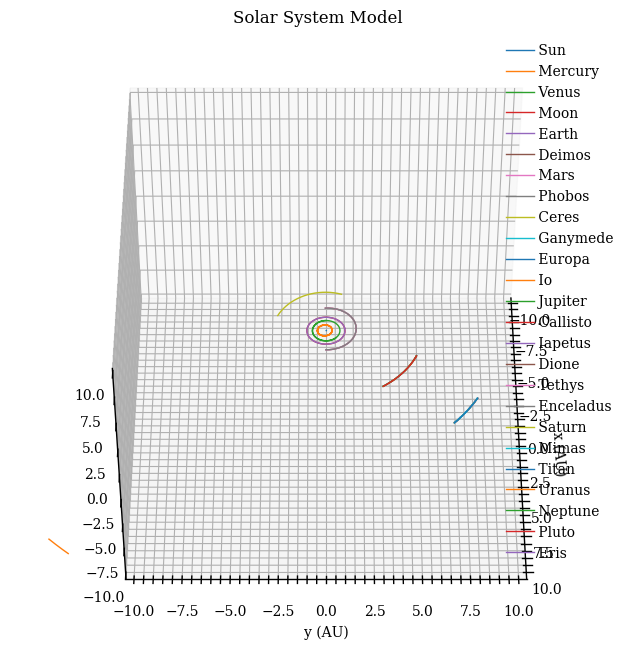

In [28]:
'''3D plot'''

plt.figure(figsize = (8,8))
ax = plt.axes(projection ='3d')

for planet in object_arr:
    name = planet.name
    ax.plot3D(SolarSys.r_arrays[name][:,0]/AU, SolarSys.r_arrays[name][:,1]/AU,
              SolarSys.r_arrays[name][:,2]/AU, label = " "+name)

plt.title("Solar System Model")
plt.xlabel("x (AU)")
plt.ylabel("y (AU)")

# rotate and zoom
ax.view_init(45, 0)

rad = 10
ax.set_xlim3d(-rad, rad)
ax.set_ylim3d(-rad, rad)
ax.set_zlim3d(-rad, rad)

'''ax.set_xlim3d(-1.652, -1.655)
ax.set_ylim3d(-0.1, 0.1)
ax.set_zlim3d(-0.075, -0.025)'''

plt.legend()
#plt.axis('equal')
plt.show()

In [30]:
'''Testing plotly interactive 3D plot'''

import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

data = []

for planet in object_arr:
    name = planet.name

    # Configure the trace.
    trace = go.Scatter3d(
        x = SolarSys.r_arrays[name][:,0]/AU,
        y = SolarSys.r_arrays[name][:,1]/AU,
        z = SolarSys.r_arrays[name][:,2]/AU,
        marker = {'size': 0.1},
        line = {'width': 2},
        name = name)

    data.append(trace)

# Configure the layout.
layout = go.Layout(margin = {'l': 0, 'r': 0, 'b': 0, 't': 0}, 
                   scene = dict(aspectmode = 'cube',
                                xaxis={'range':[-2,2]},
                                yaxis={'range':[-2,2]},
                                zaxis={'range':[-0.5,0.5]}))
plot_figure = go.Figure(data = data, layout = layout)

# Render the plot.
plotly.offline.iplot(plot_figure)